In [1]:
import pandas as pd
import warnings
warnings.filterwarnings('ignore')

In [2]:
# Reading file and stroing it in df
df = pd.read_csv("https://opendata.maryland.gov/api/views/65du-s3qu/rows.csv")

#### Geospatial Analysis

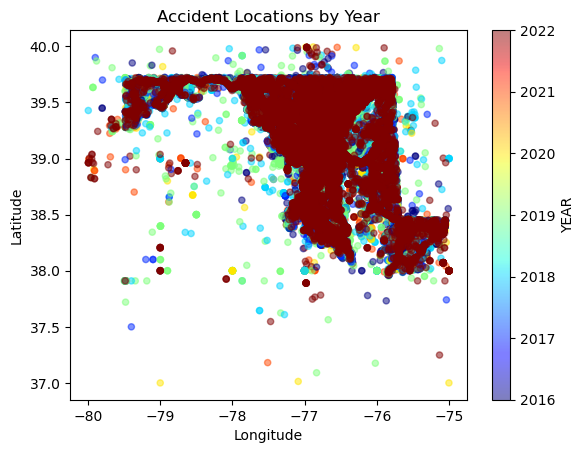

In [11]:
# accident locations by year chart
import matplotlib.pyplot as plt
df.plot(kind='scatter', x='LONGITUDE', y='LATITUDE', alpha=0.5, c='YEAR', cmap=plt.get_cmap('jet'), colorbar=True)
plt.title('Accident Locations by Year')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

In [12]:
import folium
from folium.plugins import HeatMap

# Creating a map centered on Maryland
m = folium.Map(location=[39.0458, -76.6413], zoom_start=8)

# Adding a heatmap layer to the map showing the density of crashes
crashes = df[['LATITUDE', 'LONGITUDE']].values
HeatMap(crashes).add_to(m)

# Displaying the map
m

### Feature Modeling

In [3]:
df.dropna(subset=['WEATHER_CODE', 'LIGHT_CODE', 'SURF_COND_CODE','REPORT_TYPE'], inplace=True)

report_type_dict = {'Property Damage Crash': 0, 'Injury Crash': 1, 'Fatal Crash': 2}

# Replacing each value in the REPORT_TYPE column with its corresponding number
df['REPORT_TYPE'] = df['REPORT_TYPE'].replace(report_type_dict)

In [4]:
import numpy as np
from sklearn.model_selection import train_test_split

# Split the data into training and testing sets
X = df[['LIGHT_CODE','WEATHER_CODE','SURF_COND_CODE','HARM_EVENT_CODE1','HARM_EVENT_CODE2','RD_COND_CODE']]
y = df['REPORT_TYPE']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

### Logistic Regression

In [5]:
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LogisticRegression

# Train the model
model = LogisticRegression(C=1.0, solver='liblinear', max_iter=100)
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Evaluate the model
accuracy_lg = accuracy_score(y_test, y_pred)
print('Accuracy:', accuracy_lg)

Accuracy: 0.6992883460354313


### Decision Tree Classifier

In [6]:
from sklearn.tree import DecisionTreeClassifier

# Define the model
model = DecisionTreeClassifier(criterion='gini', max_depth=10, min_samples_split=2, min_samples_leaf=1)

# Train the model
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Evaluate the model
accuracy_dt = accuracy_score(y_test, y_pred)
print('Accuracy:', accuracy_dt)

Accuracy: 0.7248703953392794


### Random Forest Classifier

In [7]:
from sklearn.ensemble import RandomForestClassifier

# Define the model
model = RandomForestClassifier(n_estimators=100, max_depth=20, min_samples_split=2, min_samples_leaf=1)

# Train the model
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Evaluate the model
accuracy_rf = accuracy_score(y_test, y_pred)
print('Accuracy:', accuracy_rf)

Accuracy: 0.7239907420092148


### Gradient Boosting

In [8]:
from sklearn.ensemble import GradientBoostingClassifier

# Define the model
model = GradientBoostingClassifier(n_estimators=100, max_depth=5, min_samples_split=2, learning_rate=0.1)

# Train the model
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Evaluate the model
accuracy_gb = accuracy_score(y_test, y_pred)
print('Accuracy:', accuracy_gb)

Accuracy: 0.7258293616745138


##### Printing Accuracy scores of all models

In [9]:
print('Accuracy of Logistic Regression Model:', accuracy_lg)
print('Accuracy of Decision Tree Model:', accuracy_dt)
print('Accuracy of Random Forest Model:', accuracy_rf)
print('Accuracy of Gradient Boosting Model:', accuracy_gb)

Accuracy of Logistic Regression Model: 0.6992883460354313
Accuracy of Decision Tree Model: 0.7248703953392794
Accuracy of Random Forest Model: 0.7239907420092148
Accuracy of Gradient Boosting Model: 0.7258293616745138


Based on above accuracy scores gradient boosting model is performing better than other three models